# Set

In [2]:
import scanpy as sc

# data handle
import pandas as pd
import numpy as np
import os; import re
from scipy.stats import median_abs_deviation

# plot
import matplotlib.pyplot as plt
import seaborn as sns

In [16]:
# Figure preset
sc.settings.set_figure_params(
    dpi=80,
    facecolor="white",
    figsize = (8, 8),
    frameon=False,
)

In [4]:
parent_dir = '/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Input/Data/Raw/'

# Ref

scanpy:
- [Preprocessing and clustering 3k PBMCs — scanpy-tutorials 1.4.7.dev38+g3e4e434 documentation](https://scanpy-tutorials.readthedocs.io/en/latest/pbmc3k.html)
- [scanpy.external.pp.harmony_integrate — Scanpy 0.1.0.dev documentation](https://scanpy.readthedocs.io/en/stable/generated/scanpy.external.pp.harmony_integrate.html)

Tutorials:
- [Single-cell best practices — Single-cell best practices](https://www.sc-best-practices.org/preamble.html)
- [single_cell_tutorial Readthedocs](https://single-cell-tutorial.readthedocs.io/zh/latest/)

# Raw

In [3]:
raw_db = "GSE167297 GSE150290 GSE134520 GSE162115 SRP400582 HRA000704 GSE159929 CRA002586 HRA003647 E-MTAB-9221".split(" ")

In [4]:
raw_db

['GSE167297',
 'GSE150290',
 'GSE134520',
 'GSE162115',
 'SRP400582',
 'HRA000704',
 'GSE159929',
 'CRA002586',
 'HRA003647',
 'E-MTAB-9221']

In [29]:
adata_list = []
for db in raw_db:
    path = os.path.join(parent_dir, db)
    files = os.listdir(path)
    dirs = list(filter(lambda x: re.match('GSM|SRR|CRX|HRR|UPN', x) != None, files))
    dirs_path = [path + "/" + str(i) for i in dirs]
    for files in dirs_path:
        adata = sc.read_10x_mtx(
            path = files,
            var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
            cache=True  
        )
        adata.obs['batch'] = os.path.basename(files)
        adata.obs['database'] = db
        print(files.replace(path, ""))
        adata_list.append(adata)

... writing an h5ad cache file to speedup reading next time
GSM5101014
... writing an h5ad cache file to speedup reading next time
GSM5101015
... writing an h5ad cache file to speedup reading next time
GSM5101016
... writing an h5ad cache file to speedup reading next time
GSM5101017
... writing an h5ad cache file to speedup reading next time
GSM5101018
... writing an h5ad cache file to speedup reading next time
GSM5101019
... writing an h5ad cache file to speedup reading next time
GSM5101021
... writing an h5ad cache file to speedup reading next time
GSM5101020
... writing an h5ad cache file to speedup reading next time
GSM5101022
... writing an h5ad cache file to speedup reading next time
GSM5101023
... writing an h5ad cache file to speedup reading next time
GSM5101024
... writing an h5ad cache file to speedup reading next time
GSM5101026
... writing an h5ad cache file to speedup reading next time
GSM5101025
... writing an h5ad cache file to speedup reading next time
GSM5101013
... wr

In [47]:
adata_list.append(adata)

In [ ]:
len(adata_list)

In [31]:
adata = sc.concat(adata_list, merge='same')

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [84]:
adata.obs['database'].value_counts()

GSE150290      338663
HRA000704      211958
SRP400582      176177
HRA003647      149332
GSE134520       59195
CRA002586       58603
GSE162115       54362
GSE167297       32718
GSE159929        7398
E-MTAB-9221      4185
Name: database, dtype: int64

# Reference work

## stanford

In [33]:
adata_stanford = sc.read_h5ad("Output/01/adata_GSE206785.h5ad")

In [34]:
adata_stanford

AnnData object with n_obs × n_vars = 111109 × 25255
    obs: 'nCount_RNA', 'nFeature_RNA', 'Sample', 'Patient', 'Tissue', 'Platform', 'Subtype', 'Type', 'Annotation', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'ref_celltype'
    var: 'name', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Annotation_colors', 'Type_colors', 'batch_colors', 'hvg', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_pca_harmony_scaled', 'X_pca_harmony_unscaled', 'X_pca_raw', 'X_pca_raw_scaled', 'X_pca_raw_unscaled', 'X_umap', 'X_umap_harmony', 'X_umap_harmony_scaled', 'X_umap_harmony_unscaled', 'X_umap_raw', 'X_umap_raw_scaled', 'X_umap_raw_unscaled', 'X_umap_scaled_harmony', 'X_umap_scaled_raw'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


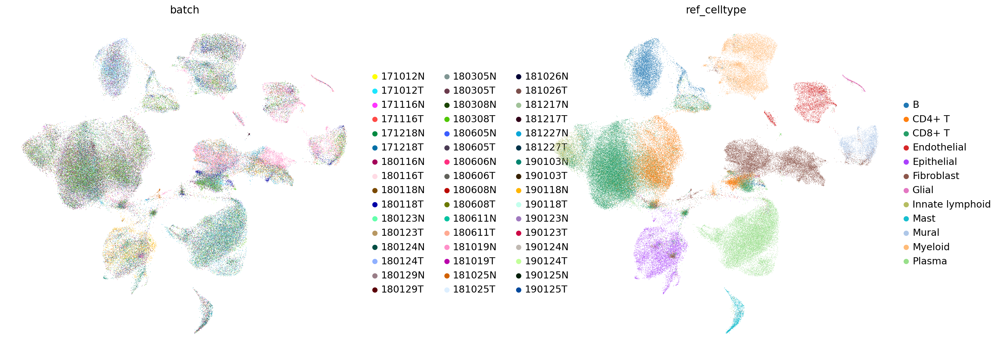

In [51]:
sc.pl.embedding(adata_stanford, color=['batch', 'ref_celltype'], 
                basis = "X_umap_scaled_harmony", wspace=0.35, show=True)

# Save before filter

In [113]:
adata.write_h5ad("Output/02/adata_raw.h5ad", compression='gzip')

In [114]:
adata

AnnData object with n_obs × n_vars = 1092591 × 36601
    obs: 'batch', 'database'
    var: 'gene_ids'

# Filter

Ref: [Evolution of immune and stromal cell states and ecotypes during gastric adenocarcinoma progression: Cancer Cell](https://www.cell.com/cancer-cell/fulltext/S1535-6108(23)00215-5)

- `>` 15% mito;
- `>` 6500 genes;
- < 200 UMI;
- < 3 genes

This step aimed to remove cell debris, empty drops, and low-quality cells. Likely dying or apoptotic cells where >15%

Remove doublets:

Ref: [swolock/scrublet: Detect doublets in single-cell RNA-seq data](https://github.com/swolock/scrublet)

When working with data from multiple samples, run Scrublet on each sample separately. Because Scrublet is designed to detect technical doublets formed by the random co-encapsulation of two cells, it may perform poorly on merged datasets where the cell type proportions are not representative of any single sample.

## Before

In [85]:
adata

AnnData object with n_obs × n_vars = 1092591 × 36601
    obs: 'batch', 'database'
    var: 'gene_ids'

In [101]:
counts_df = adata.obs.groupby(["batch", "database"]).size().reset_index(name='count')
counts_df

,batch,database,count
0,CRX107889,CRA002586,3757
1,CRX107890,CRA002586,3760
2,CRX107891,CRA002586,6132
3,CRX107892,CRA002586,5013
4,CRX107893,CRA002586,1223
...,...,...,...
156,SRR21999142,SRP400582,16717
157,SRR21999143,SRP400582,19683
158,UPN2,E-MTAB-9221,1624
159,UPN3,E-MTAB-9221,1241


/tmp/ipykernel_14721/1293581659.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation= 90)


[Text(0, 0, 'CRA002586'),
 Text(1, 0, 'GSE134520'),
 Text(2, 0, 'GSE159929'),
 Text(3, 0, 'GSE167297'),
 Text(4, 0, 'HRA000704'),
 Text(5, 0, 'HRA003647'),
 Text(6, 0, 'GSE150290'),
 Text(7, 0, 'GSE162115'),
 Text(8, 0, 'SRP400582'),
 Text(9, 0, 'E-MTAB-9221')]

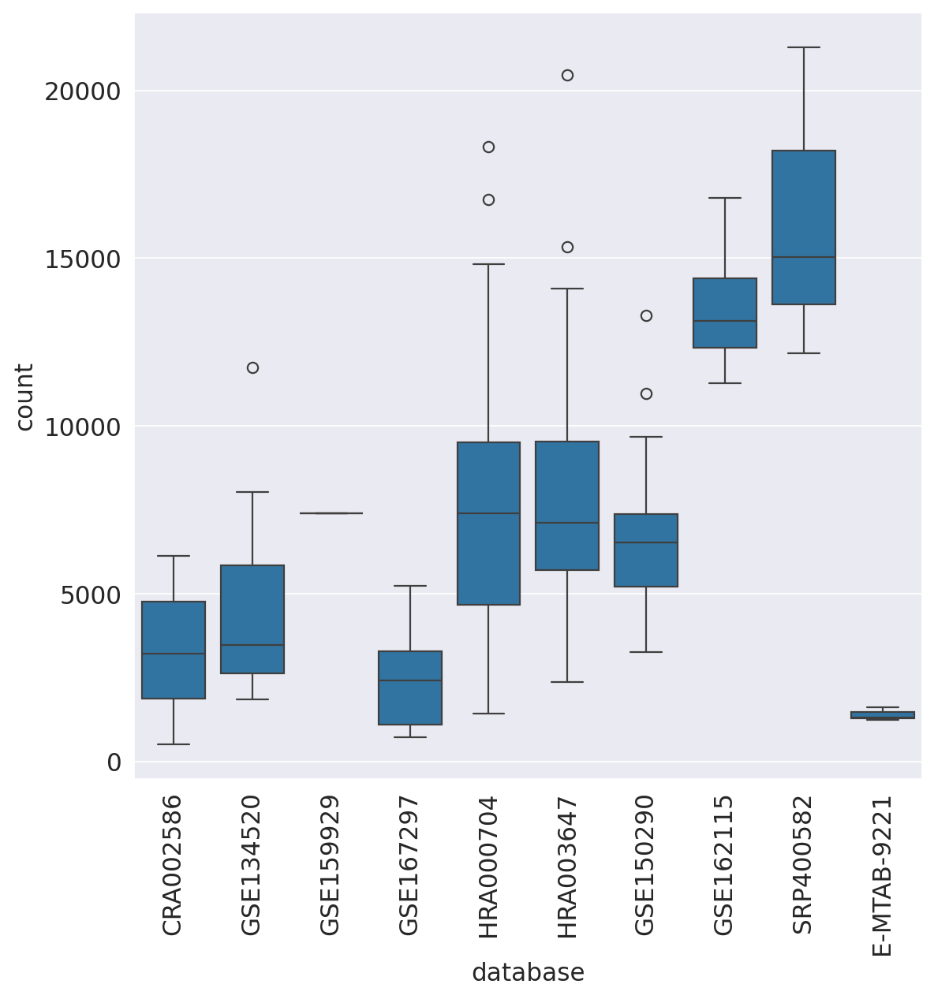

In [102]:
sns.set_style('darkgrid')
ax = sns.boxplot(data=counts_df, 
            y='count', x='database')
ax.set_xticklabels(ax.get_xticklabels(), rotation= 90)            

In [ ]:
sc.pl.highest_expr_genes(adata, n_top=20)

In [106]:
len(adata.obs.batch.unique())

161

## Remove doublets

In [107]:
tmp = adata.obs['batch'].value_counts() > 500
tmp.value_counts()

True    161
Name: batch, dtype: int64

In [115]:
adata_list = []
for batch in adata.obs.batch.unique():
  adata_s = adata[adata.obs.batch == batch, :]
  sc.external.pp.scrublet(adata_s, random_state=1)
  adata_s = adata_s[~adata_s.obs['predicted_doublet'].astype(bool), :]
  adata_list.append(adata_s)

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.36
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 8.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 7.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.39
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 6.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 10.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.42
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 12.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.39
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 14.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 4.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.32
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.50
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.50
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 6.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.33
Detected doublet rate = 0.7%
Estimated detectable doublet fraction = 19.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.34
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 24.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 18.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.32
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 15.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.31
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 6.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 30.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 5.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.26
Detected doublet rate = 1.9%
Estimated detectable doublet fraction = 29.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.25
Detected doublet rate = 1.7%
Estimated detectable doublet fraction = 22.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.64
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 17.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.25
Detected doublet rate = 1.8%
Estimated detectable doublet fraction = 26.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 3.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.29
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 22.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.26
Detected doublet rate = 1.5%
Estimated detectable doublet fraction = 23.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 4.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.26
Detected doublet rate = 1.4%
Estimated detectable doublet fraction = 22.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.23
Detected doublet rate = 1.9%
Estimated detectable doublet fraction = 25.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 4.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.22
Detected doublet rate = 2.5%
Estimated detectable doublet fraction = 37.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.28
Detected doublet rate = 1.7%
Estimated detectable doublet fraction = 22.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 1.7%
Estimated detectable doublet fraction = 24.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 6.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.36
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 11.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 4.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.25
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 33.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 4.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 4.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.20
Detected doublet rate = 2.6%
Estimated detectable doublet fraction = 23.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.25
Detected doublet rate = 1.9%
Estimated detectable doublet fraction = 27.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 3.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.22
Detected doublet rate = 2.2%
Estimated detectable doublet fraction = 27.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 3.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.51
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 3.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.66
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.65
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 12.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 16.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.71
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.18
Detected doublet rate = 6.1%
Estimated detectable doublet fraction = 51.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.13
Detected doublet rate = 9.3%
Estimated detectable doublet fraction = 57.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 16.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.10
Detected doublet rate = 12.8%
Estimated detectable doublet fraction = 67.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 18.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.16
Detected doublet rate = 8.0%
Estimated detectable doublet fraction = 56.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 14.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.17
Detected doublet rate = 6.5%
Estimated detectable doublet fraction = 55.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 28.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.19
Detected doublet rate = 5.5%
Estimated detectable doublet fraction = 46.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.17
Detected doublet rate = 5.9%
Estimated detectable doublet fraction = 42.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.17
Detected doublet rate = 6.2%
Estimated detectable doublet fraction = 55.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.15
Detected doublet rate = 7.6%
Estimated detectable doublet fraction = 56.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.34
Detected doublet rate = 0.6%
Estimated detectable doublet fraction = 18.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 1.1%
Estimated detectable doublet fraction = 27.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 20.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 20.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.26
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 9.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.29
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 36.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.51
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.51
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 2.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 12.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.46
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 7.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.26
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 36.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.47
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 14.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 4.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.33
Detected doublet rate = 1.2%
Estimated detectable doublet fraction = 27.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 15.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.38
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 22.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 1.5%
Estimated detectable doublet fraction = 24.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 16.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 1.0%
Estimated detectable doublet fraction = 22.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 27.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.17
Detected doublet rate = 6.0%
Estimated detectable doublet fraction = 40.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 14.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.6%
Estimated detectable doublet fraction = 16.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.22
Detected doublet rate = 3.1%
Estimated detectable doublet fraction = 36.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 8.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.23
Detected doublet rate = 2.4%
Estimated detectable doublet fraction = 31.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 9.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 2.5%
Estimated detectable doublet fraction = 33.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 8.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 3.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.63
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 3.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 37.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 37.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.57
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.50
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 1.4%
Estimated detectable doublet fraction = 26.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 28.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.70
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.23
Detected doublet rate = 3.8%
Estimated detectable doublet fraction = 48.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.44
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 10.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 3.0%
Estimated detectable doublet fraction = 51.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.7%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.46
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.28
Detected doublet rate = 1.3%
Estimated detectable doublet fraction = 19.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.6%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.19
Detected doublet rate = 5.1%
Estimated detectable doublet fraction = 60.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 8.5%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.54
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 6.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.32
Detected doublet rate = 0.8%
Estimated detectable doublet fraction = 19.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.21
Detected doublet rate = 3.3%
Estimated detectable doublet fraction = 30.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 10.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.68
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.65
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.46
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 12.9%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.44
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.1%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.64
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.55
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.39
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 14.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.42
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 2.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.8%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.3%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.53
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 1.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 19.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 4.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 5.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.45
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 9.9%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 7.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.2%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.58
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.4%


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']


In [116]:
adata_s = sc.concat(adata_list, merge='same')

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/merge.py:1263: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  concat_annot = pd.concat(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [117]:
adata_s

AnnData object with n_obs × n_vars = 1074982 × 36601
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids'

In [118]:
adata_s.obs['predicted_doublet'] = adata_s.obs['predicted_doublet'].astype(bool)

In [120]:
pd.DataFrame({'before': adata.obs['database'].value_counts(), 
              'after': adata_s.obs['database'].value_counts()})

,before,after
GSE150290,338663,336621
HRA000704,211958,210032
SRP400582,176177,165033
HRA003647,149332,147185
GSE134520,59195,59143
CRA002586,58603,58380
GSE162115,54362,54358
GSE167297,32718,32656
GSE159929,7398,7394
E-MTAB-9221,4185,4180


In [121]:
adata = adata_s.copy()

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


## Basic Remove

In [122]:
# mitochondrial genes
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes.
adata.var["hb"] = adata.var_names.str.contains(("^HB[^(P)]"))

In [141]:
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 853718 × 35093
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'log1p_total_counts_hb'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts'

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same

<Axes: ylabel='value'>

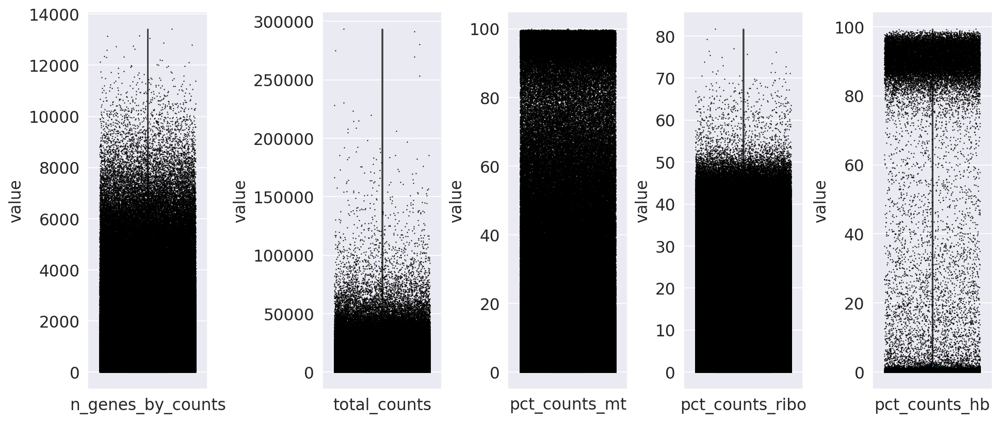

In [132]:
fig, axs = plt.subplots(1, 5, figsize=(12,5),constrained_layout=True)
sc.pl.violin(adata, ['n_genes_by_counts'], 
             jitter=0.4, ax=axs[0], show=False)
sc.pl.violin(adata, ['total_counts'],
             jitter=0.4, ax=axs[1], show=False)
sc.pl.violin(adata, ['pct_counts_mt'],
             jitter=0.4, ax=axs[2], show=False)
sc.pl.violin(adata, ['pct_counts_ribo'], 
             jitter=0.4, ax=axs[3], show=False)
sc.pl.violin(adata, ['pct_counts_hb'], 
             jitter=0.4, ax=axs[4], show=False)

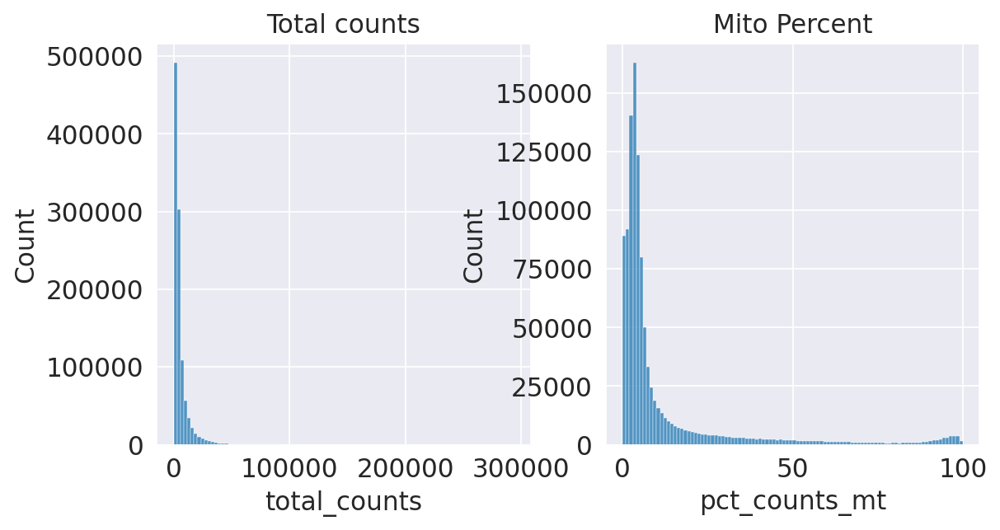

In [134]:
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
p1 = sns.histplot(adata.obs["total_counts"], bins=100, kde=False, ax=axes[0])
axes[0].set_title("Total counts")
p2 = sns.histplot(adata.obs["pct_counts_mt"], bins=100, kde=False, ax=axes[1])
axes[1].set_title("Mito Percent")
plt.show()

In [136]:
adata_backup = adata.copy()

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [138]:
sc.pp.filter_cells(adata, max_genes=6500)
sc.pp.filter_cells(adata, min_counts=200)
sc.pp.filter_genes(adata, min_cells=3)
adata = adata[adata.obs["pct_counts_mt"] < 15,]

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Outlier 5md

In [139]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
        np.median(M) + nmads * median_abs_deviation(M) < M
    )
    return outlier

In [146]:
adata.obs["outlier"] = (
    is_outlier(adata, "log1p_total_counts", 5)
    | is_outlier(adata, "log1p_n_genes_by_counts", 5)
)
adata.obs.outlier.value_counts()

False    835768
True      17950
Name: outlier, dtype: int64

In [147]:
adata = adata[~adata.obs["outlier"].astype(bool),]

In [151]:
pd.DataFrame({'before': adata_backup.obs['database'].value_counts(), 
              'after': adata.obs['database'].value_counts()})

,before,after
CRA002586,58380,50730
E-MTAB-9221,4180,3432
GSE134520,59143,44481
GSE150290,336621,243305
GSE159929,7394,6269
GSE162115,54358,35958
GSE167297,32656,24932
HRA000704,210032,170278
HRA003647,147185,111298
SRP400582,165033,145085


In [150]:
adata

View of AnnData object with n_obs × n_vars = 835768 × 35093
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'log1p_total_counts_hb', 'outlier'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts'

## after check

In [158]:
counts_df2 = adata.obs.groupby(["database", "batch"]).size().reset_index(name='count')
counts_df2 = counts_df2[counts_df2['count'] > 0]
counts_df2

,database,batch,count
0,CRA002586,CRX107889,3211
1,CRA002586,CRX107890,3452
2,CRA002586,CRX107891,4713
3,CRA002586,CRX107892,4685
4,CRA002586,CRX107893,749
...,...,...,...
1602,SRP400582,SRR21999139,82
1603,SRP400582,SRR21999140,13785
1604,SRP400582,SRR21999141,13900
1605,SRP400582,SRR21999142,14984


/tmp/ipykernel_14721/3044398356.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation= 90)


[Text(0, 0, 'CRA002586'),
 Text(1, 0, 'E-MTAB-9221'),
 Text(2, 0, 'GSE134520'),
 Text(3, 0, 'GSE150290'),
 Text(4, 0, 'GSE159929'),
 Text(5, 0, 'GSE162115'),
 Text(6, 0, 'GSE167297'),
 Text(7, 0, 'HRA000704'),
 Text(8, 0, 'HRA003647'),
 Text(9, 0, 'SRP400582')]

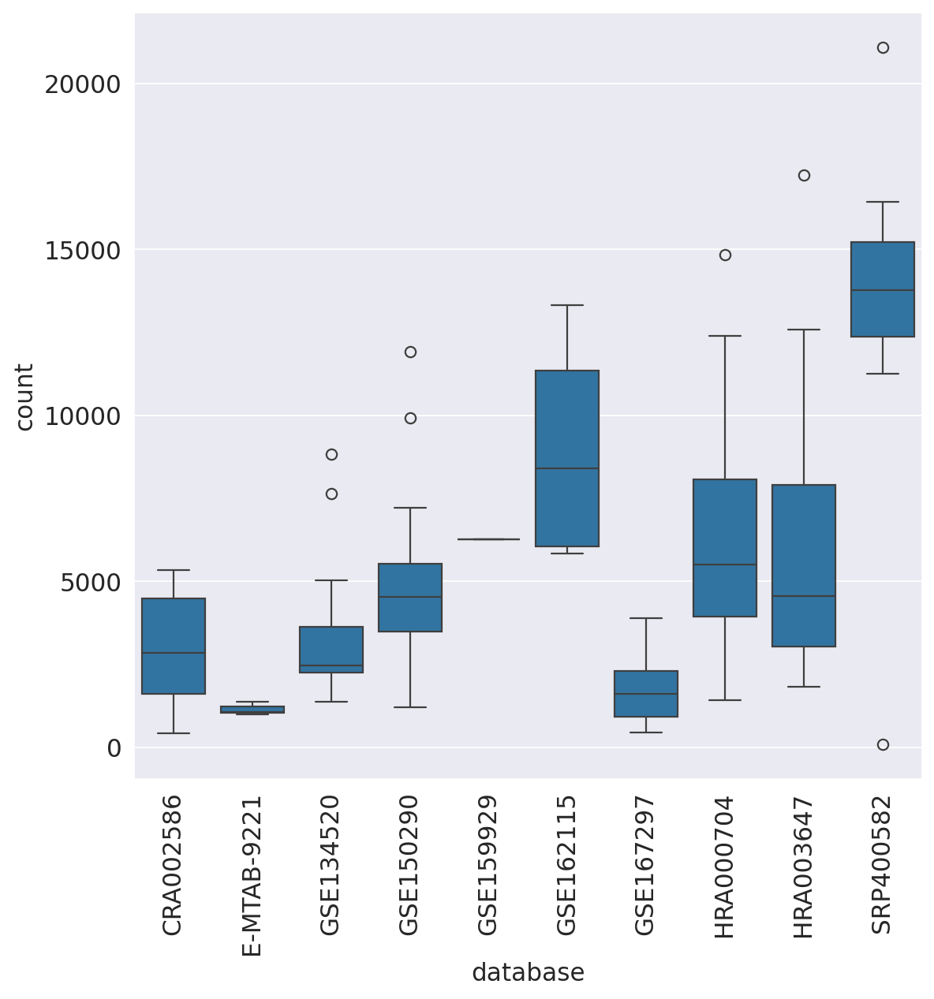

In [159]:
sns.set_style('darkgrid')
ax = sns.boxplot(data=counts_df2, 
            y='count', x='database')
ax.set_xticklabels(ax.get_xticklabels(), rotation= 90)            

In [163]:
counts_df2[counts_df2['count'] < 500 ]

,database,batch,count
8,CRA002586,CRX107897,423
998,GSE167297,GSM5101013,468
1010,GSE167297,GSM5101025,435
1602,SRP400582,SRR21999139,82


In [194]:
counts_df2['database'].unique()

['CRA002586', 'E-MTAB-9221', 'GSE134520', 'GSE150290', 'GSE159929', 'GSE162115', 'GSE167297', 'HRA000704', 'HRA003647', 'SRP400582']
Categories (10, object): ['CRA002586', 'E-MTAB-9221', 'GSE134520', 'GSE150290', ..., 'GSE167297', 'HRA000704', 'HRA003647', 'SRP400582']

In [169]:
adata = adata[~adata.obs["batch"].isin(counts_df2[counts_df2['count'] < 500 ].batch.tolist()),]

In [171]:
len(adata.obs["batch"].unique())

157

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same

<Axes: ylabel='value'>

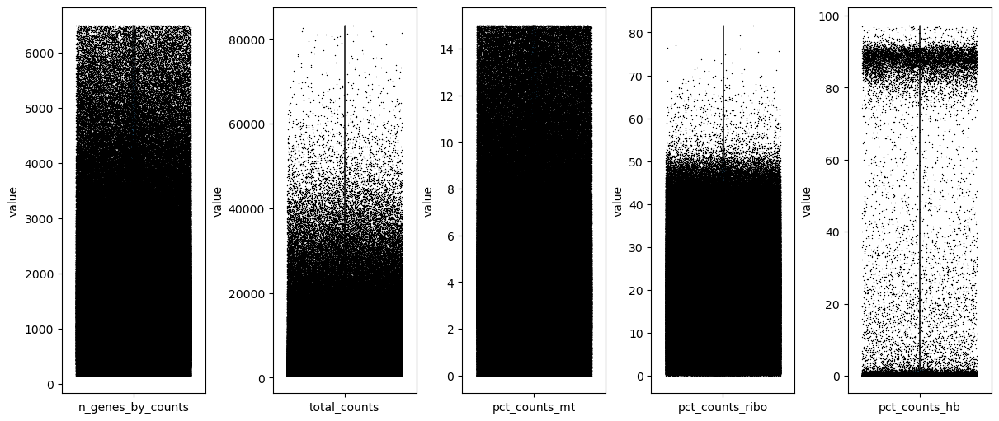

In [5]:
fig, axs = plt.subplots(1, 5, figsize=(12,5),constrained_layout=True)
sc.pl.violin(adata, ['n_genes_by_counts'], 
             jitter=0.4, ax=axs[0], show=False)
sc.pl.violin(adata, ['total_counts'],
             jitter=0.4, ax=axs[1], show=False)
sc.pl.violin(adata, ['pct_counts_mt'],
             jitter=0.4, ax=axs[2], show=False)
sc.pl.violin(adata, ['pct_counts_ribo'], 
             jitter=0.4, ax=axs[3], show=False)
sc.pl.violin(adata, ['pct_counts_hb'], 
             jitter=0.4, ax=axs[4], show=False)

## Merge Clinical data

## Clinical data

In [196]:
sample_df = pd.read_excel('../../Input/Clinical/Sample.xlsx', sheet_name=0) 

In [197]:
sample_df

,Sample_Code,Official_Set_Code,Sample_Name1,Sample_Name2,Tissue_Type1,Tissue_Type2,Tissue_Type3,Platform,Data_Source,Type,Patient_Code
0,MUST-SAMPLE-001,GSE167297,Pt1_normal,GSM5101013,Cancer,Normal adjacent tissue (NAT),NaN,10x,fq,RNA,MUST-PATIENT-001
1,MUST-SAMPLE-002,GSE167297,Pt1_superficial_cancer,GSM5101014,Cancer,Primary tumor,superficial,10x,fq,RNA,MUST-PATIENT-001
2,MUST-SAMPLE-003,GSE167297,Pt1_deep_cancer,GSM5101015,Cancer,Primary tumor,deep,10x,fq,RNA,MUST-PATIENT-001
3,MUST-SAMPLE-004,GSE167297,Pt2_superficial_cancer,GSM5101016,Cancer,Primary tumor,superficial,10x,fq,RNA,MUST-PATIENT-002
4,MUST-SAMPLE-005,GSE167297,Pt2_deep_cancer,GSM5101017,Cancer,Primary tumor,deep,10x,fq,RNA,MUST-PATIENT-002
...,...,...,...,...,...,...,...,...,...,...,...
287,MUST-SAMPLE-288,stanford_Ji,6709_n1,6709_n1,Cancer,Normal adjacent tissue (NAT),NaN,10x,processed,RNA,MUST-PATIENT-158
288,MUST-SAMPLE-289,stanford_Ji,6709_t1,6709_t1,Cancer,Primary tumor,NaN,10x,processed,RNA,MUST-PATIENT-158
289,MUST-SAMPLE-290,E-MTAB-9221,UPN2,UPN2,PBMC,PBMC Health,NaN,10x,fq,RNA,MUST-PATIENT-159
290,MUST-SAMPLE-291,E-MTAB-9221,UPN3,UPN3,PBMC,PBMC Health,NaN,10x,fq,RNA,MUST-PATIENT-160


In [187]:
sample_df_count = sample_df.groupby(["Tissue_Type1", "Data_Source"]).size().unstack().fillna(0)
sample_df_count

Data_Source,fq,processed
Tissue_Type1,,
Cancer,128.0,116.0
Health,4.0,0.0
Metastasis,0.0,10.0
PBMC,18.0,4.0
Precancer,9.0,1.0
TIL,2.0,0.0


## Merge

In [206]:
adata.obs_names_make_unique()

In [208]:
obs_df = adata.obs
obs_df['cellbarcode'] = obs_df.index

In [209]:
obs_df.head()

,batch,database,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,pct_counts_in_top_20_genes,total_counts_mt,pct_counts_mt,total_counts_ribo,...,pct_counts_hb,n_genes,n_counts,log1p_n_genes_by_counts,log1p_total_counts,log1p_total_counts_mt,log1p_total_counts_ribo,log1p_total_counts_hb,outlier,cellbarcode
AAAGAACCAATTGCAC-1,UPN5,E-MTAB-9221,0.031600,False,421,532.0,15.789474,30.0,5.639098,18.0,...,0.939850,421,532.0,6.045005,6.278522,3.433987,2.944439,1.791759,False,AAAGAACCAATTGCAC-1
AAAGGATGTCCCTCAT-1,UPN5,E-MTAB-9221,0.045226,False,810,1206.0,14.013267,68.0,5.638474,118.0,...,0.995025,810,1206.0,6.698268,7.095893,4.234107,4.779123,2.564949,False,AAAGGATGTCCCTCAT-1
AAAGGTACATTCACCC-1,UPN5,E-MTAB-9221,0.052632,False,448,548.0,15.328467,13.0,2.372263,76.0,...,0.729927,448,548.0,6.107023,6.308098,2.639057,4.343805,1.609438,False,AAAGGTACATTCACCC-1
AAAGTGACACCCAAGC-1,UPN5,E-MTAB-9221,0.056934,False,2868,8489.0,16.527271,803.0,9.459300,333.0,...,0.070680,2868,8489.0,7.961719,9.046644,6.689600,5.811141,1.945910,False,AAAGTGACACCCAAGC-1
AAATGGAGTGACCGTC-1,UPN5,E-MTAB-9221,0.052632,False,1041,2641.0,21.923514,26.0,0.984476,13.0,...,0.000000,1041,2641.0,6.948897,7.879292,3.295837,2.639057,0.000000,False,AAATGGAGTGACCGTC-1


In [190]:
sample_df[~sample_df['Sample_Name2'].isin(obs_df['batch'])]['Data_Source'].value_counts()

processed    131
fq             5
Name: Data_Source, dtype: int64

In [198]:
obs_df["batch"].isin(sample_df['Sample_Name2']).value_counts()

True    834360
Name: batch, dtype: int64

In [210]:
obs_df_merged = pd.merge(obs_df, sample_df, left_on='batch', right_on='Sample_Name2', how='inner')

In [211]:
obs_df_merged.index = obs_df_merged['cellbarcode'] 

In [214]:
adata.obs = obs_df_merged

In [215]:
adata.obs['Tissue_Type1'].value_counts()

Cancer       592023
PBMC         173085
Precancer     36081
TIL           20761
Health        12410
Name: Tissue_Type1, dtype: int64

In [216]:
adata.obs['Tissue_Type2'].value_counts()

Primary tumor                       390295
Normal adjacent tissue (NAT)        222489
PBMC Tumor                          169653
Chronic atrophic gastritis (CAG)     21509
intestinal metaplasia (IM)           14572
Normal gastric tissue (NGT)          12410
PBMC Health                           3432
Name: Tissue_Type2, dtype: int64

In [ ]:
# after filter
adata.write_h5ad("Output/02/adata_filtered.h5ad", compression='gzip')

# Intergratation

Using the first 50 principal components, a neighborhood graph was calculated with the number of neighbors set to k = 30. Data were subsequently clustered with Louvain clustering at a resolution of r = 0.25.

In [3]:
adata = sc.read_h5ad("Output/02/adata_filtered.h5ad")

In [88]:
adata

AnnData object with n_obs × n_vars = 834360 × 35093
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'log1p_total_counts_hb', 'outlier', 'cellbarcode', 'Sample_Code', 'Official_Set_Code', 'Sample_Name1', 'Sample_Name2', 'Tissue_Type1', 'Tissue_Type2', 'Tissue_Type3', 'Platform', 'Data_Source', 'Type', 'Patient_Code'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts'

In [93]:
adata_rawcounts = adata.X.copy()

## Before

In [9]:
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers["logcounts"] = adata.X.copy()

In [16]:
adata.layers["counts"][1,].toarray().max()

24.0

In [17]:
adata.X[1,].toarray().max()

5.298342

In [19]:
sc.pp.highly_variable_genes(
    adata, n_top_genes=3000, batch_key = "batch", flavor="seurat"
)

In [17]:
n_batches = adata.var["highly_variable_nbatches"].value_counts()
n_batches

0     20818
1      8059
2      3014
3      1069
4       591
5       418
6       339
7       321
8       255
9       159
10       50
Name: highly_variable_nbatches, dtype: int64

In [20]:
# restore the original adata
adata.raw = adata
adata = adata[:, adata.var.highly_variable]

In [21]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata, max_value=10)

In [22]:
sc.tl.pca(adata, n_comps = 50)
sc.pp.neighbors(adata, n_neighbors=30)
sc.tl.umap(adata)

In [23]:
adata.obsm["X_umap_raw"] = adata.obsm["X_umap"]
adata.obsm["X_pca_raw"] = adata.obsm["X_pca"]

In [38]:
adata.obs.groupby(["Tissue_Type1", "database"]).size().unstack().fillna(0)

database,CRA002586,E-MTAB-9221,GSE134520,GSE150290,GSE159929,GSE162115,GSE167297,HRA000704,HRA003647,SRP400582
Tissue_Type1,,,,,,,,,,
Cancer,50307,0,2259,243305,0,35958,24029,124867,111298,0
Health,0,0,6141,0,6269,0,0,0,0,0
PBMC,0,3432,0,0,0,0,0,24650,0,145003
Precancer,0,0,36081,0,0,0,0,0,0,0
TIL,0,0,0,0,0,0,0,20761,0,0


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


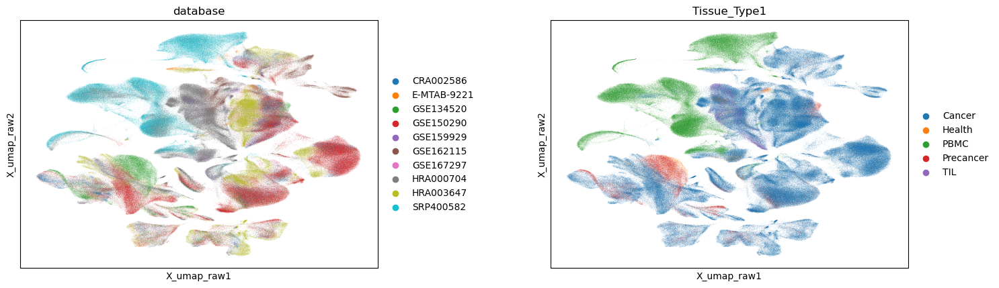

In [35]:
sc.pl.embedding(adata, color=['database', 'Tissue_Type1'], basis = "X_umap_raw",
                wspace=0.35,
                show=True)

In [94]:
# restore full data
adata.uns["scale.data"] = adata.X
adata = adata.raw.to_adata()
adata.layers["counts"] = adata_rawcounts

In [95]:
adata

AnnData object with n_obs × n_vars = 834360 × 35093
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'log1p_total_counts_hb', 'outlier', 'cellbarcode', 'Sample_Code', 'Official_Set_Code', 'Sample_Name1', 'Sample_Name2', 'Tissue_Type1', 'Tissue_Type2', 'Tissue_Type3', 'Platform', 'Data_Source', 'Type', 'Patient_Code', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res0_1', 'leiden_res0_2', 'leiden_res1', 'leiden_res2', 'scibet_res', 'scsa_res1', 'scsa_res2'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispe

## Harmony

In [24]:
sc.external.pp.harmony_integrate(adata, key= "database", basis='X_pca_raw')

2024-02-23 15:17:03,063 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


2024-02-23 15:24:54,011 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-02-23 15:24:57,181 - harmonypy - INFO - Iteration 1 of 10
2024-02-23 15:33:22,649 - harmonypy - INFO - Iteration 2 of 10
2024-02-23 15:40:20,928 - harmonypy - INFO - Iteration 3 of 10
2024-02-23 15:47:06,045 - harmonypy - INFO - Iteration 4 of 10
2024-02-23 15:53:52,253 - harmonypy - INFO - Iteration 5 of 10
2024-02-23 16:00:43,720 - harmonypy - INFO - Iteration 6 of 10
2024-02-23 16:07:28,353 - harmonypy - INFO - Iteration 7 of 10
2024-02-23 16:14:21,904 - harmonypy - INFO - Iteration 8 of 10
2024-02-23 16:21:18,188 - harmonypy - INFO - Iteration 9 of 10
2024-02-23 16:28:13,054 - harmonypy - INFO - Converged after 9 iterations


In [25]:
sc.pp.neighbors(adata, use_rep = "X_pca_harmony",  n_neighbors=30)
sc.tl.umap(adata)
adata.obsm["X_umap_harmony"] = adata.obsm["X_umap"]

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


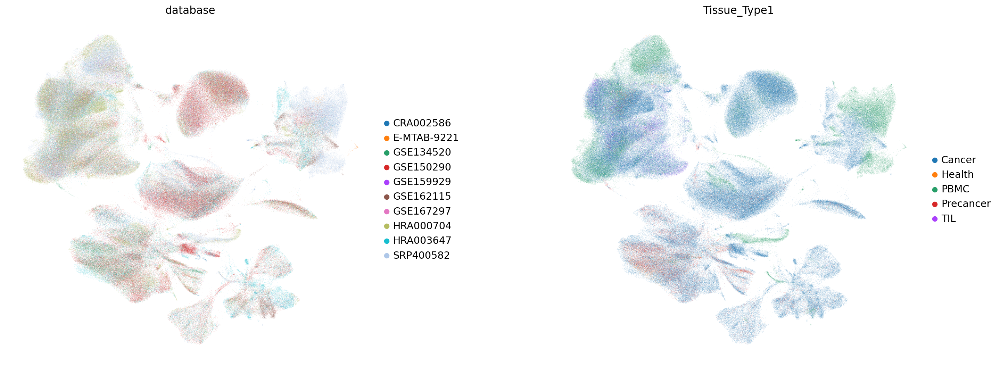

In [26]:
sc.pl.embedding(adata, color=['database', 'Tissue_Type1'], basis = "X_umap_harmony",
                wspace=0.35,
                show=True)

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'harmony'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>

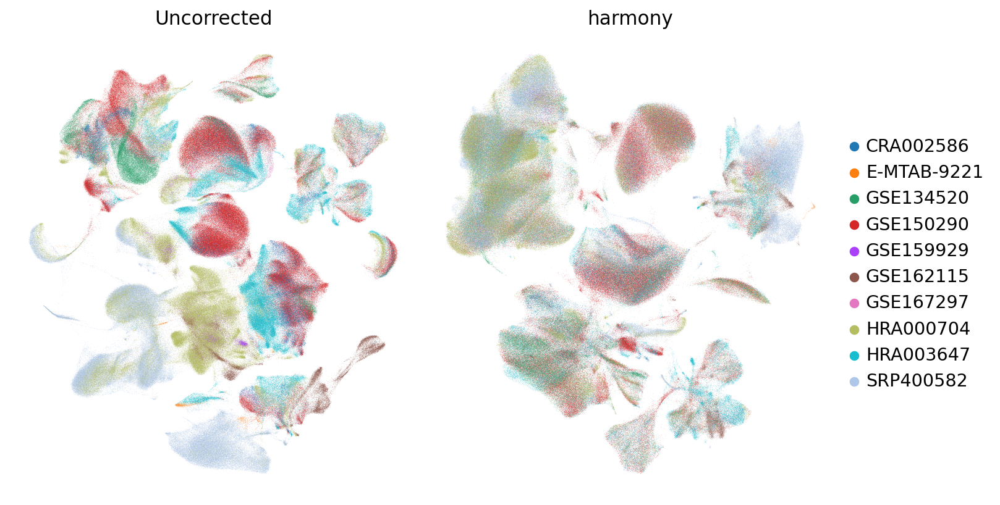

In [27]:
fig, axs = plt.subplots(1, 2, figsize=(10,5),constrained_layout=True)
sc.pl.embedding(adata, color="database", basis = "X_umap_raw", title="Uncorrected", ax=axs[0], show=False, legend_loc = None)
sc.pl.embedding(adata, color="database", basis = "X_umap_harmony", title="harmony", ax=axs[1], show=False)

## After

<Axes: title={'center': 'highlight'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>

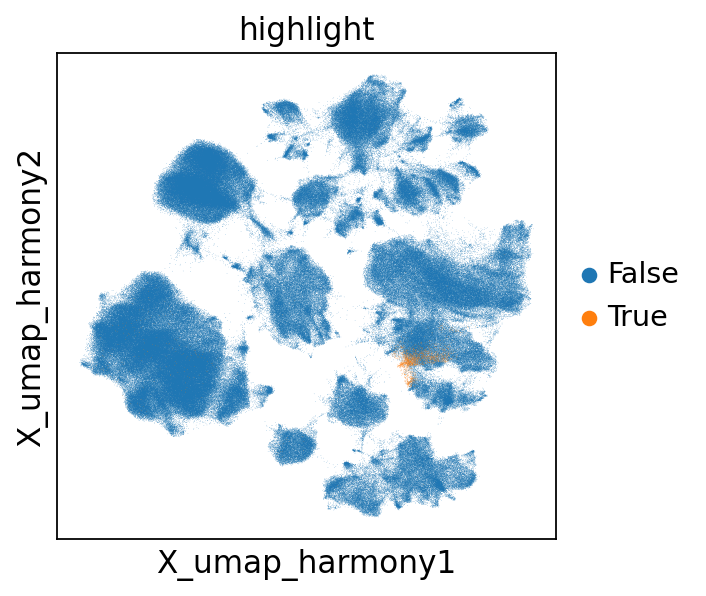

In [18]:
adata.obs['highlight'] = adata.obs['batch'].isin(["GSM3954958"])
adata.obs['highlight'] = adata.obs['highlight'].astype(str)
sc.pl.embedding(adata, color=['highlight'], basis = "X_umap_harmony", show=False)

# Cell Type Identification

In [10]:
adata = sc.read_h5ad("Output/02/adata_integrated.h5ad")

In [11]:
adata

AnnData object with n_obs × n_vars = 834360 × 35093
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'log1p_total_counts_hb', 'outlier', 'cellbarcode', 'Sample_Code', 'Official_Set_Code', 'Sample_Name1', 'Sample_Name2', 'Tissue_Type1', 'Tissue_Type2', 'Tissue_Type3', 'Platform', 'Data_Source', 'Type', 'Patient_Code', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res0_1', 'leiden_res0_2', 'leiden_res1', 'leiden_res2', 'scibet_res', 'scsa_res1', 'scsa_res2', 'highlight', 'major_celltype'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts', 'highly_variable',

## Cluster

In [5]:
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1)
sc.tl.leiden(adata, key_added="leiden_res2", resolution=2)

In [8]:
adata.obs['leiden_res1'] = adata.obs['leiden_res0_1']
adata.obs['leiden_res2'] = adata.obs['leiden_res0_2']

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'leiden_res0_25'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'leiden_res0_5'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'leiden_res1'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'leiden_res2'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>]

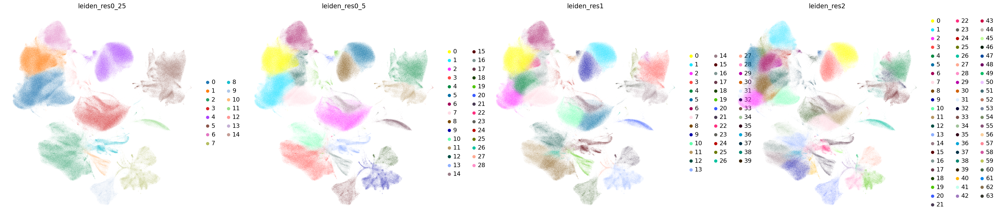

In [9]:
sc.pl.embedding(adata, color=['leiden_res0_25','leiden_res0_5',
                              'leiden_res1', 'leiden_res2'], basis = "X_umap_harmony", show=False)

## Scibet

Expression profiles should be library size normalized(CPM, TPM, etc). Performance would be further improved if only informative genes are included. Please refer to our sample files for dataset formats.

[SciBet](http://scibet.cancer-pku.cn/download_references.html)

In [ ]:
# adata_hvg = adata.raw.to_adata()
# sc.pp.highly_variable_genes(
#     adata_hvg, n_top_genes = 5000, batch_key = "database", flavor="cell_ranger"
# )
# adata_hvg = adata_hvg[:, adata_hvg.var['highly_variable']]
# adata_hvg.X[1,].toarray().max()

### Input

In [44]:
# adata 
adata.layers['counts']

<834360x3000 sparse matrix of type '<class 'numpy.float32'>'
	with 146674390 stored elements in Compressed Sparse Row format>

In [99]:
import scipy.io as sio

In [34]:
sio.mmwrite('temp/adata_hvg_scibet.mtx', adata.layers['counts'])
pd.DataFrame(adata.var_names).to_csv("temp/adata_hvg_scibet_gene.csv",
                                         header = False, 
                                         index=False)

pd.DataFrame(adata.obs_names).to_csv("temp/adata_hvg_scibet_cellbarcode.csv",
                                         header = False, 
                                         index=False)

In [37]:
# ref
adata_stanford = sc.read_h5ad("Output/01/adata_stanford.h5ad")
adata_stanford

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/anndata/_core/anndata.py:1898: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 36159 × 33538
    obs: 'batch', 'database', 'barcode', 'condition', 'final_celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'ref_celltype'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'batch_colors', 'final_celltype_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_pca_harmony_scaled', 'X_pca_harmony_unscaled', 'X_pca_raw', 'X_pca_raw_scaled', 'X_pca_raw_unscaled', 'X_umap', 'X_umap_harmony', 'X_umap_harmony_scaled', 'X_umap_harmony_unscaled', 'X_umap_raw', 'X_umap_raw_scaled', 'X_umap_raw_unscaled', 'X_umap_scaled_harmony', 'X_umap_scaled_raw'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'connectivities', 'distances'

In [45]:
sio.mmwrite('temp/ref_scibet.mtx', adata_stanford.layers["counts"])
pd.DataFrame(adata_stanford.var_names).to_csv("temp/ref_scibet_gene.csv",
                                         header = False, 
                                         index=False)

pd.DataFrame(adata_stanford.obs_names).to_csv("temp/ref_scibet_cellbarcode.csv",
                                         header = False, 
                                         index=False)

In [48]:
adata_stanford.obs['ref_celltype'].to_csv("temp/ref_scibet_label.csv",
                                         header = False, 
                                         index=False)

### Load result

In [124]:
scibet_res = pd.read_csv('Output/02/scibet_result.csv')
scibet_res

,label
0,macrophage
1,macrophage
2,CD4
3,NK
4,macrophage
...,...
834355,CD4
834356,CD8
834357,CD4
834358,CD4


In [125]:
adata.obs['scibet_res'] = scibet_res['label'].to_list()

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'leiden_res0_25'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'scibet_res'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>]

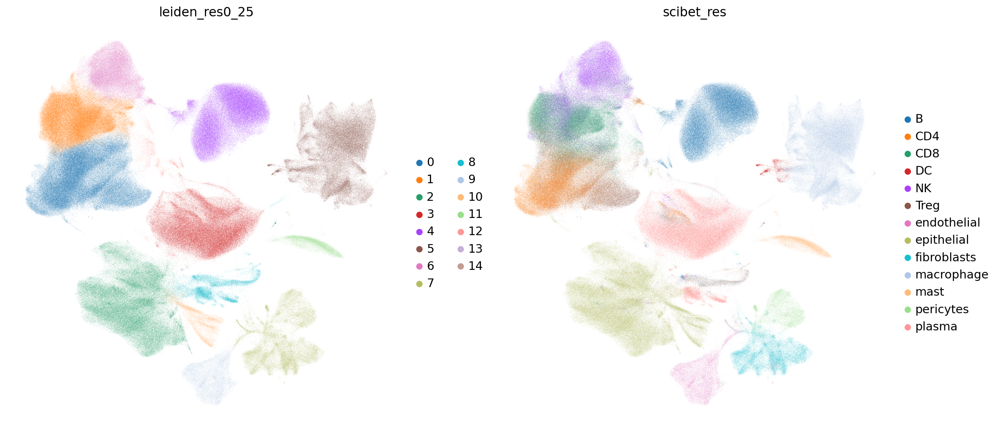

In [ ]:
sc.pl.embedding(adata, color=['leiden_res0_25',
                              'scibet_res'], basis = "X_umap_harmony", show=False)

In [115]:
adata.obs.groupby(["leiden_res0_25", "scibet_res"]).size().unstack().fillna(0)

scibet_res,B,CD4,CD8,DC,NK,Treg,endothelial,epithelial,fibroblasts,macrophage,mast,pericytes,plasma
leiden_res0_25,,,,,,,,,,,,,
0,880,76534,22745,585,5778,33008,204,1299,632,1842,294,418,9349
1,83,3228,77602,73,31409,2708,42,235,218,788,56,99,1893
2,278,417,203,134,362,243,65,110997,263,631,92,227,489
3,1671,3372,1231,170,1359,625,134,592,139,975,151,88,91879
4,95942,10,176,36,8,24,39,232,16,109,9,17,570
5,29,50,18,3672,48,38,11,55,82,85630,6,41,47
6,14,1022,5475,76,40592,147,8,16,21,59,28,9,59
7,4,189,19,42,29,78,1218,89,28779,1390,218,12396,43
8,1069,500,418,764,384,647,265,3230,237,3160,468,387,9780


## SCSA

[bioinfo-ibms-pumc/SCSA: SCSA: cell type annotation for single-cell RNA-seq data](https://github.com/bioinfo-ibms-pumc/SCSA)

In [24]:
from Code.SCSA.SCSA import *
from Code.SCSA.run_SCSA2 import *

In [9]:
sc.tl.rank_genes_groups(adata, "leiden_res0_25", method='wilcoxon')

ranking genes
    finished (2:13:48)


In [25]:
scsa_res = run_SCSA(adata,
                    celltype = "normal", 
                    clustertype = "leiden_res0_25", model_path = "Data/SCSA/whole_v2.db",
                    rank_rep = False)

Version V2.1 [2023/06/27]
DB load: GO_items:47347,Human_GO:3,Mouse_GO:3,
CellMarkers:91969,CancerSEA:1574,
Ensembl_HGNC:37440,Ensembl_Mouse:23
Version V2.1 [2023/06/27]
DB load: GO_items:47347,Human_GO:3,Mouse_GO:3,
CellMarkers:91969,CancerSEA:1574,
Ensembl_HGNC:37440,Ensembl_Mouse:23
load markers: 77000
Cluster 0 Gene number: 544


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7605
Cluster 1 Gene number: 500


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7655
Cluster 10 Gene number: 2856


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7443
Cluster 11 Gene number: 700


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7635
Cluster 12 Gene number: 1266


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7218
Cluster 13 Gene number: 27


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7712
Cluster 14 Gene number: 3393


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 6587
Cluster 2 Gene number: 3366


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7161
Cluster 3 Gene number: 657


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7608
Cluster 4 Gene number: 572


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7594
Cluster 5 Gene number: 1800


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7573
Cluster 6 Gene number: 655


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7540
Cluster 7 Gene number: 3895


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7144
Cluster 8 Gene number: 93


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7682
Cluster 9 Gene number: 2476


/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)
/data1/bioteam_usr/yzpeng/1-project/0817_GastricGroupEnvir/Code/altas_0129/Code/SCSA/SCSA.py:254: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_outs = all_outs.append(outs)


Other Gene number: 7522
['0', '?', 'T cell|Regulatory T(Treg) cell', '12.469866855729174|7.20410878727162', 1.7309381665309127]
['1', '?', 'T cell|Natural killer cell', '11.17542883938458|10.228094665588815', 1.0926207866439637]
['10', '?', 'Neuron|Epithelial cell', '14.738219059300967|9.237602004743016', 1.5954594116236744]
['11', 'Good', 'Mast cell', 18.448169570211565, 5.198979079308613]
['12', '?', 'Natural killer T (NKT) cell|Neural progenitor cell', '9.030798259436043|7.691467308535216', 1.1741320475242185]
['13', '?', 'Plasma cell|B cell', '4.4509430860062915|3.7260290166366428', 1.194554059062053]
['14', 'Good', 'Monocyte', 16.47975049930598, 2.037829196471177]
['2', '?', 'Epithelial cell|Goblet cell', '13.77801471731331|8.70254984301587', 1.5832158351119006]
['3', '?', 'B cell|Plasma cell', '10.10586937878012|9.576028109538422', 1.055329961773393]
['4', 'Good', 'B cell', 16.700753678914907, 4.210581406100951]
['5', '?', 'Monocyte|Macrophage', '14.345014561517951|11.10605825209

In [75]:
scsa_res["cellbarcode_scsa"].equals(adata.obs["cellbarcode"])

True

In [76]:
scsa_res

,cellbarcode_scsa,Cluster,CellType1,Z-score1,CellType2,Z-score2,Quality
cellbarcode_scsa,,,,,,,
AAAGAACCAATTGCAC-1,AAAGAACCAATTGCAC-1,5,Monocyte,14.345015,Macrophage,11.106058,bad
AAAGGATGTCCCTCAT-1,AAAGGATGTCCCTCAT-1,5,Monocyte,14.345015,Macrophage,11.106058,bad
AAAGGTACATTCACCC-1,AAAGGTACATTCACCC-1,2,Epithelial cell,13.778015,Goblet cell,8.702550,bad
AAAGTGACACCCAAGC-1,AAAGTGACACCCAAGC-1,1,T cell,11.175429,Natural killer cell,10.228095,bad
AAATGGAGTGACCGTC-1,AAATGGAGTGACCGTC-1,5,Monocyte,14.345015,Macrophage,11.106058,bad
...,...,...,...,...,...,...,...
TTTGTCAGTGTTCGAT-1-2,TTTGTCAGTGTTCGAT-1-2,0,T cell,12.469867,Regulatory T(Treg) cell,7.204109,bad
TTTGTCAGTTATCACG-1,TTTGTCAGTTATCACG-1,6,Natural killer cell,15.605978,Natural killer T (NKT) cell,3.170054,good
TTTGTCAGTTCCCTTG-1-1,TTTGTCAGTTCCCTTG-1-1,0,T cell,12.469867,Regulatory T(Treg) cell,7.204109,bad


In [78]:
adata.obs['scsa_res1'] = scsa_res['CellType1']
adata.obs['scsa_res2'] = scsa_res['CellType2']

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'leiden_res0_25'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'scsa_res1'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'scsa_res2'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>]

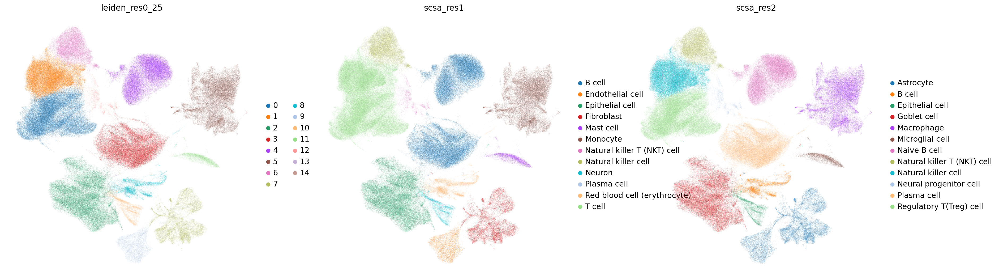

In [80]:
sc.pl.embedding(adata, color=['leiden_res0_25',
                              'scsa_res1',
                              'scsa_res2'], basis = "X_umap_harmony", show=False)

## SingleR

[dviraran/SingleR: SingleR: Single-cell RNA-seq cell types Recognition (legacy version)](https://github.com/dviraran/SingleR)

In [ ]:
sio.mmwrite('temp/ref_singler.mtx', adata_stanford.X)
sio.mmwrite('temp/adata_hvg_singler.mtx', adata.X)

In [81]:
adata.obs["leiden_res0_25"].to_csv("temp/adata_leiden.csv",
                                         header = False, 
                                         index=False)

In [12]:
singler_res = pd.read_csv('Output/02/singler_result.csv')
singler_res

,label
0,macrophage
1,macrophage
2,epithelial
3,NK
4,macrophage
...,...
834355,Treg
834356,NK
834357,Treg
834358,Treg


In [13]:
adata.obs['singler_res'] = singler_res['label'].tolist()

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'leiden_res0_25'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'singler_res'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>]

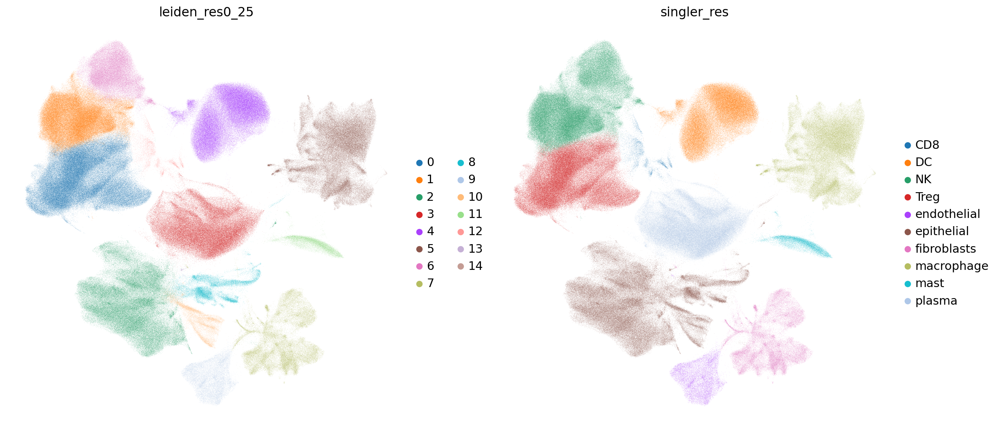

In [129]:
sc.pl.embedding(adata, color=['leiden_res0_25',
                              'singler_res'], basis = "X_umap_harmony", show=False)

## Manual annotation

ref: [Parallel single-cell and bulk transcriptome analyses reveal key features of the gastric tumor microenvironment - PMC](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9773611/#Sec2title)


In [104]:
marker_genes1 = {
    "B": ["CD19", "MS4A1", "CD79A"],
    "plasma": ["IGHG1", "IGHA1", "JCHAIN"],
    "T": ["CD3D", "CD3E", "CD3G"],
    "CD4": ["CD4", "IL7R", "FOXP3"],
    "CD8": ["CD8A", "CD8B", "CCL5"],
    "NK": ["GNLY", "FGFBP2", "NCR1", "GZMB", "GNLY", "GZMA"],
    "Myeloid": ["ITGAX", "CD14", "CD68"],
    "Mast": ["TPSAB1", "TPSB2", "KIT"],
    "Endothelial": ["PECAM1", "CLDN5", "RAMP2"],
    "Epithelial": ["PGC", "PGA3", "MUC5AC"],
    "Fib": ["COL1A1","DCN", "LUM", "PDGFRA"],
    "Mural": ["RGS5", "PDGFRB", "ACTA2"], # Pericytes
    "Glial": ["CDH19", "PLP1", "S0X10"]
}

ref: [Single cell genomic characterization reveals the cellular reprogramming of the gastric tumor microenvironment - PMC](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7269843/)

In [109]:
marker_genes2 = {
    "epithelial cells": ["PGC", "TFF1", "MUC5AC", "EPCAM", "GIF", "CHGA"],
    "fibroblasts": ["THY1", "DCN", "COL4A1", "FAP"],
    "endothelial cells": ["PECAM", "ENG", "VWF", "SELE"],
    "Pericytes": ["PDGFRB", "RGS5"],
    "immune": ["PTPRC"],
    "CD4": ["CD3D", "CD4", "IL7"],
    "CD8": ["CD3D", "CD8A", "CD8B"],
    "regulatory T": ["FOXP3", "IL2RA"],
    "NK": ["NKG7", "GNLY"],
    "B": ["CD19", "MS4A1", "CD79A"],
    "plasma": ["IGHG1", "IGHA1","SDC1"],
    "Mast": ["TPSAB1"],
    "Macro": ["CD68", "CD14", "FCGR3A"]
}

### Main Anno

Ref1:

In [105]:
marker_genes_in_data = dict()
for ct, markers in marker_genes1.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res0_25']`
categories: 0, 1, 2, etc.
var_group_labels: B, plasma, T, etc.


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


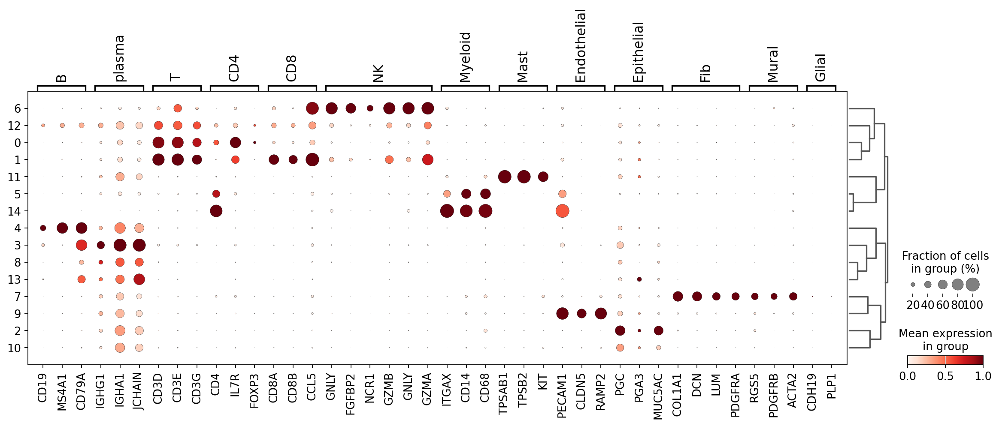

In [107]:
sc.tl.dendrogram(adata, groupby = 'leiden_res0_25')
sc.pl.dotplot(
    adata,
    groupby="leiden_res0_25",
    var_names=marker_genes_in_data,
    dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
)

In [111]:
marker_genes_in_data = dict()
for ct, markers in marker_genes2.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res0_25']`
categories: 0, 1, 2, etc.
var_group_labels: epithelial cells, fibroblasts, endothelial cells, etc.


/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


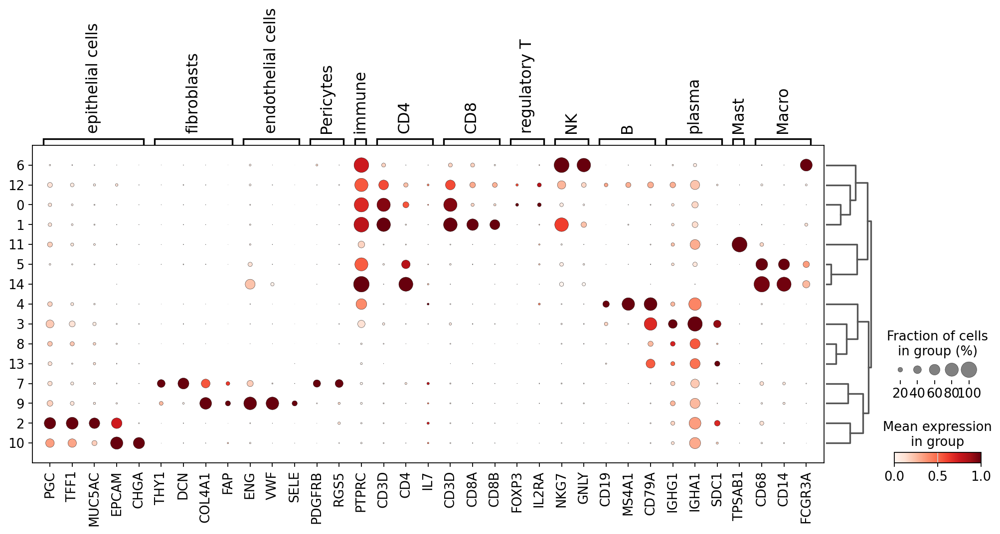

In [113]:
sc.tl.dendrogram(adata, groupby = 'leiden_res0_25')
sc.pl.dotplot(
    adata,
    groupby="leiden_res0_25",
    var_names=marker_genes_in_data,
    dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
)

highlight

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'highlight'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>

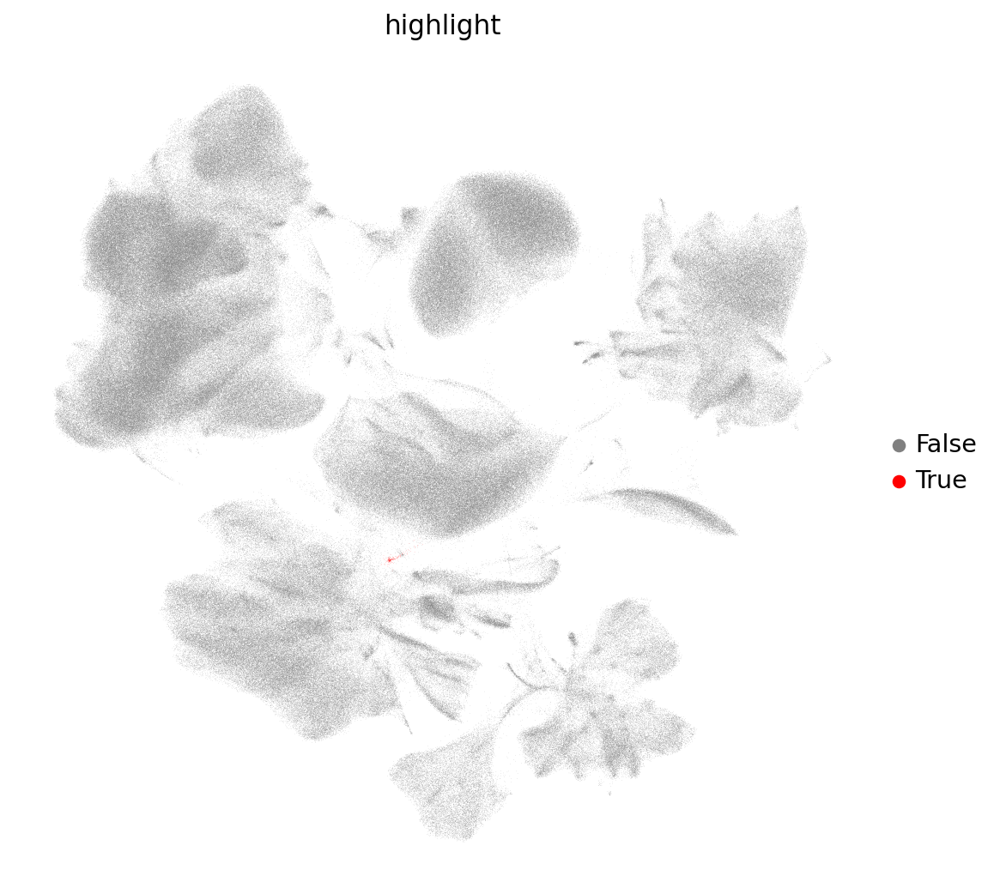

In [117]:
adata.obs['highlight'] = adata.obs['leiden_res0_25'].isin(['13'])
adata.obs['highlight'] = adata.obs['highlight'].astype(str)
sc.pl.embedding(adata, color=['highlight'],
                palette={"False":"grey","True":"red"},
                basis = "X_umap_harmony", show=False)

label

In [118]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
     '0': 'CD4T',
     '1': 'CD8T',
     '2': 'Epithelial',
     '3': 'Plasma cell',
     '4': 'B cell',
     '5': 'Macro',
     '6': 'NK',
     '7': 'Fibro/Pericytes',
     '8': 'Plasma cell',
     '9': 'Endothelial',
     '10': 'Epithelial',
     '11': 'Mast',
     '12': 'Plasma cell',
     '13': 'Plasma cell',
     '14': 'Macro'
}
adata.obs['major_celltype'] = adata.obs['leiden_res0_25'].map(cluster2annotation).astype('category')

plot results

/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/pengyz/miniconda3/envs/sc_py3/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for co

[<Axes: title={'center': 'scibet_res'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'scsa_res1'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'scsa_res2'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'singler_res'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'major_celltype'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>,
 <Axes: title={'center': 'leiden_res0_25'}, xlabel='X_umap_harmony1', ylabel='X_umap_harmony2'>]

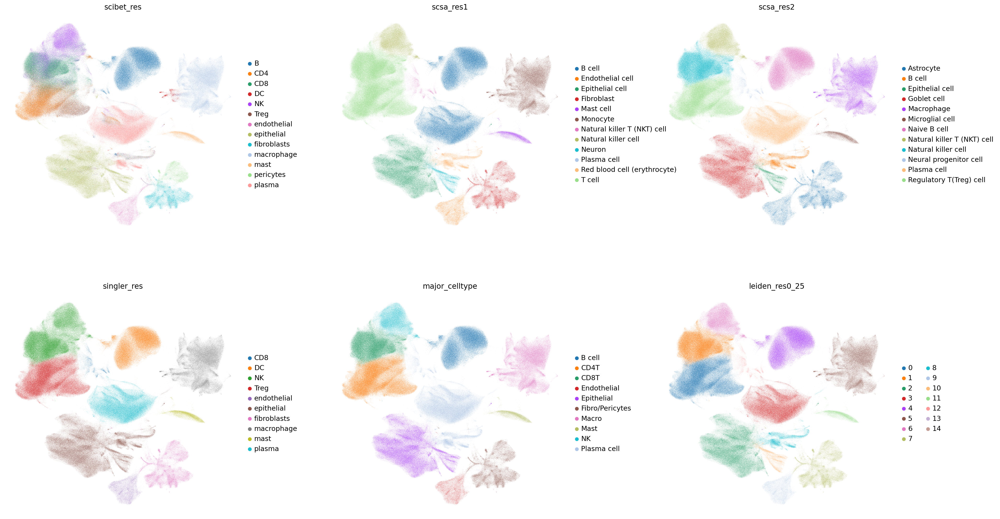

In [17]:
sc.pl.embedding(adata, color=['scibet_res', 
                              'scsa_res1',
                              'scsa_res2',
                              'singler_res',
                              'major_celltype',
                              'leiden_res0_25'], 
                              ncols = 3,
                              wspace=0.25,
                              basis = "X_umap_harmony", show=False)

In [134]:
adata

AnnData object with n_obs × n_vars = 834360 × 35093
    obs: 'batch', 'database', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'log1p_total_counts_hb', 'outlier', 'cellbarcode', 'Sample_Code', 'Official_Set_Code', 'Sample_Name1', 'Sample_Name2', 'Tissue_Type1', 'Tissue_Type2', 'Tissue_Type3', 'Platform', 'Data_Source', 'Type', 'Patient_Code', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res0_1', 'leiden_res0_2', 'leiden_res1', 'leiden_res2', 'scibet_res', 'scsa_res1', 'scsa_res2', 'highlight', 'major_celltype', 'singler_res'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'log1p_mean_counts', 'log1p_total_counts', 'hi

# Save

In [138]:
adata.obs.to_csv("Output/02/adata_integrated_obs.csv", index=True)

In [120]:
# Final output after step2
adata.write_h5ad("Output/02/adata_integrated.h5ad", compression='gzip')